In [1]:
import os
from tqdm.notebook import tqdm
import json

import torch
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader
import torch.nn.functional as F

import numpy as np
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.preprocessing import RobustScaler
import matplotlib.pyplot as plt

from rdkit import Chem
from rdkit.Chem import Draw

import networkx as nx
import pandas as pd
%matplotlib inline
import seaborn as sns


from src.utils import create_edge_index, PLIDataset, set_all_seeds, GCN, GNN7L_Sage, save_model, GNN7L_GraphConv

In [2]:
DATA_PATH = 'data/pdbbind/dataset/'
SAVE_FOLDER = 'results/explanations/'
CLASSIFICATION = False
UNDIRECTED = True
PLOT = True
SAVE_RESULTS = False
LIGAND_GRAPH = True
PROTEIN_GRAPH = True

STATISTICS_FOLDER = "results/explanations/regression/20 samples GraphConv edge weights correct predictions/"

CLEAN_DATA = True
MIN_AFFINITY = 5
MAX_AFFINITY = 11
NUM_CLASSES = 1
CLASS_THRESHOLD = 7

AFFINITY_GROUP = "medium" #mean is from 6.5 to 7.5 extremes inlcueded, low is below 6 and high is above 8.
MEAN_LOWER_BOUND = 6.5
MEAN_UPPER_BOUND = 7.5
LOW_BOUND = 6
HIGH_BOUND = 8

EDGE_WEIGHT = True
SCALING = True

SEED = 42
NODE_FEATURES = True #if True, Volkov features are used, if False, use dummy features (1)

set_all_seeds(42)

if CLASSIFICATION:
    NUM_CLASSES = 2

## Load dataset

#### Load affinities
Already save in JSON, can load them

In [3]:
interaction_affinities = None

with open(DATA_PATH + '/interaction_affinities.json', 'r') as fp:
    interaction_affinities = json.load(fp)

In [4]:
vals = list(interaction_affinities.values())
mean_interaction_affinity = np.mean(vals)
mean_interaction_affinity

6.395088287020752

(array([  4.,   1.,   3.,   0.,   7.,   3.,  12.,  11.,  18.,  19.,  31.,
         34.,  69.,  48.,  50.,  76.,  82., 147., 102., 162., 136., 183.,
        190., 164., 252., 223., 249., 269., 277., 331., 269., 353., 326.,
        353., 286., 349., 342., 409., 372., 425., 398., 432., 460., 407.,
        337., 428., 422., 434., 425., 450., 334., 464., 326., 357., 267.,
        154., 282., 135., 239., 128., 140.,  86.,  74.,  49.,  71.,  29.,
         30.,  22.,  35.,  21.,  22.,  23.,  10.,  27.,   6.,  10.,   9.,
          6.,   9.,   1.,   5.,   0.,   2.,   1.,   0.,   5.,   0.,   1.,
          0.,   0.,   0.,   1.,   0.,   0.,   1.,   0.,   0.,   0.,   2.,
          1.]),
 array([ 0.4   ,  0.5482,  0.6964,  0.8446,  0.9928,  1.141 ,  1.2892,
         1.4374,  1.5856,  1.7338,  1.882 ,  2.0302,  2.1784,  2.3266,
         2.4748,  2.623 ,  2.7712,  2.9194,  3.0676,  3.2158,  3.364 ,
         3.5122,  3.6604,  3.8086,  3.9568,  4.105 ,  4.2532,  4.4014,
         4.5496,  4.6978,  4.846 ,

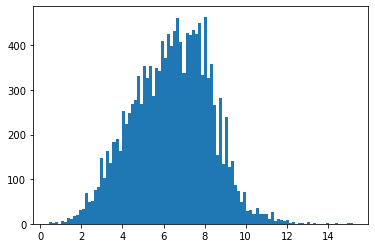

In [5]:
# min(vals), max(vals)
%matplotlib inline
plt.hist(vals, bins=100)

### remove outliers

In [6]:
affinities_df = pd.DataFrame.from_dict(interaction_affinities, orient='index', columns=['affinity'])

if CLEAN_DATA == True:
    affinities_df = affinities_df[affinities_df['affinity'] >= MIN_AFFINITY]
    affinities_df = affinities_df[affinities_df['affinity'] <= MAX_AFFINITY]

vals_cleaned = list(affinities_df['affinity'])
mean_interaction_affinity_no_outliers = np.mean(vals_cleaned)
mean_interaction_affinity_no_outliers

7.149117619537756

In [7]:
print("Number of weak interactions: ", len(affinities_df[affinities_df['affinity'] <= CLASS_THRESHOLD ]))
print("Number of strong interactions: ", len(affinities_df[affinities_df['affinity'] > CLASS_THRESHOLD ]))

Number of weak interactions:  5117
Number of strong interactions:  5570


In [8]:
affinities_df = affinities_df.sort_values(by = "affinity", ascending=True)

# pseudo_labels = pd.qcut(x = affinities_df["affinity"], q = NUM_CLASSES, labels = [i for i in range(NUM_CLASSES)])
pseudo_labels = [0 if x <= CLASS_THRESHOLD else 1 for x in affinities_df["affinity"]]
affinities_df["pseudo_label"] = pseudo_labels
interaction_affinities = affinities_df.to_dict(orient='index')
interaction_affinities

{'1pip': {'affinity': 5.0, 'pseudo_label': 0},
 '5lj2': {'affinity': 5.0, 'pseudo_label': 0},
 '5lpj': {'affinity': 5.0, 'pseudo_label': 0},
 '1nnb': {'affinity': 5.0, 'pseudo_label': 0},
 '3vbv': {'affinity': 5.0, 'pseudo_label': 0},
 '3uqg': {'affinity': 5.0, 'pseudo_label': 0},
 '5myl': {'affinity': 5.0, 'pseudo_label': 0},
 '3uii': {'affinity': 5.0, 'pseudo_label': 0},
 '5nq5': {'affinity': 5.0, 'pseudo_label': 0},
 '5o3r': {'affinity': 5.0, 'pseudo_label': 0},
 '1kr3': {'affinity': 5.0, 'pseudo_label': 0},
 '1jpl': {'affinity': 5.0, 'pseudo_label': 0},
 '1jm4': {'affinity': 5.0, 'pseudo_label': 0},
 '1inf': {'affinity': 5.0, 'pseudo_label': 0},
 '1ih0': {'affinity': 5.0, 'pseudo_label': 0},
 '1i6v': {'affinity': 5.0, 'pseudo_label': 0},
 '1hqf': {'affinity': 5.0, 'pseudo_label': 0},
 '1hlk': {'affinity': 5.0, 'pseudo_label': 0},
 '3ezr': {'affinity': 5.0, 'pseudo_label': 0},
 '6bto': {'affinity': 5.0, 'pseudo_label': 0},
 '3new': {'affinity': 5.0, 'pseudo_label': 0},
 '3dvp': {'af

In [9]:
descriptors_interaction_dict = None
num_node_features = 0
if NODE_FEATURES:
    descriptors_interaction_dict = {}
    descriptors_interaction_dict["CA"] = [1, 0, 0, 0, 0, 0, 0, 0]
    descriptors_interaction_dict["NZ"] = [0, 1, 0, 0, 0, 0, 0, 0]
    descriptors_interaction_dict["N"] = [0, 0, 1, 0, 0, 0, 0, 0]
    descriptors_interaction_dict["OG"] = [0, 0, 0, 1, 0, 0, 0, 0]
    descriptors_interaction_dict["O"] = [0, 0, 0, 0, 1, 0, 0, 0]
    descriptors_interaction_dict["CZ"] = [0, 0, 0, 0, 0, 1, 0, 0]
    descriptors_interaction_dict["OD1"] = [0, 0, 0, 0, 0, 0, 1, 0]
    descriptors_interaction_dict["ZN"] = [0, 0, 0, 0, 0, 0, 0, 1]
    num_node_features = len(descriptors_interaction_dict["CA"])

In [10]:
def generate_pli_dataset_dict(data_path):

    directory = os.fsencode(data_path)

    dataset_dict = {}
    dirs = os.listdir(directory)
    for file in tqdm(dirs):
        interaction_name = os.fsdecode(file)

        if interaction_name in interaction_affinities:
            if os.path.isdir(data_path + interaction_name):
                dataset_dict[interaction_name] = {}
                G = None
                with open(data_path + interaction_name + "/" + interaction_name + "_interaction_graph.json", 'r') as f:
                    data = json.load(f)
                    G = nx.Graph()

                    for node in data['nodes']:
                        G.add_node(node["id"], atom_type=node["attype"], origin=node["pl"]) #are we supposed to add nodes with no edges?

                    for edge in data['edges']:
                        if edge["id1"] != None and edge["id2"] != None:
                            G.add_edge(edge["id1"], edge["id2"], weight= float(edge["length"]))
                            
                            #add node attributes this way an not in the loop below
                            # G.add_node(edge["id1"], atom_type=data['nodes'][edge["id1"]]["attype"], origin = data['nodes'][edge["id1"]]["pl"])
                            # G.add_node(edge["id2"], atom_type=data['nodes'][edge["id2"]]["attype"], origin = data['nodes'][edge["id2"]]["pl"])

                    for node in data['nodes']:
                        nx.set_node_attributes(G, {node["id"]: node["attype"]}, "atom_type")
                        nx.set_node_attributes(G, {node["id"]: node["pl"]}, "origin")

                    # print(nx.to_scipy_sparse_matrix(G).tocoo())

                if LIGAND_GRAPH:
                    G_ligand = None
                    with open(data_path + interaction_name + "/" + interaction_name + "_ligand_graph.json", 'r') as f:
                        data = json.load(f)
                        G_ligand = nx.Graph()

                        for node in data['nodes']:
                            G_ligand.add_node(node["id"], atom_type=node["attype"], origin=node["pl"]) #are we supposed to add nodes with no edges?

                        for edge in data['edges']:
                            if edge["id1"] != None and edge["id2"] != None:
                                G_ligand.add_edge(edge["id1"], edge["id2"], weight= float(edge["length"]))
                                
                                #add node attributes this way an not in the loop below
                                # G.add_node(edge["id1"], atom_type=data['nodes'][edge["id1"]]["attype"], origin = data['nodes'][edge["id1"]]["pl"])
                                # G.add_node(edge["id2"], atom_type=data['nodes'][edge["id2"]]["attype"], origin = data['nodes'][edge["id2"]]["pl"])

                        for node in data['nodes']:
                            nx.set_node_attributes(G_ligand, {node["id"]: node["attype"]}, "atom_type")
                            nx.set_node_attributes(G_ligand, {node["id"]: node["pl"]}, "origin")

                        dataset_dict[interaction_name]["networkx_ligand_graph"] = G_ligand

                    if PROTEIN_GRAPH:
                        G_protein = None
                        with open(data_path + interaction_name + "/" + interaction_name + "_protein_graph.json", 'r') as f:
                            data = json.load(f)
                            G_protein = nx.Graph()

                            for node in data['nodes']:
                                G_protein.add_node(node["id"], atom_type=node["attype"], origin=node["pl"]) #are we supposed to add nodes with no edges?

                            for edge in data['edges']:
                                if edge["id1"] != None and edge["id2"] != None:
                                    G_protein.add_edge(edge["id1"], edge["id2"], weight= float(edge["length"]))
                                    
                                    #add node attributes this way an not in the loop below
                                    # G.add_node(edge["id1"], atom_type=data['nodes'][edge["id1"]]["attype"], origin = data['nodes'][edge["id1"]]["pl"])
                                    # G.add_node(edge["id2"], atom_type=data['nodes'][edge["id2"]]["attype"], origin = data['nodes'][edge["id2"]]["pl"])

                            for node in data['nodes']:
                                nx.set_node_attributes(G_protein, {node["id"]: node["attype"]}, "atom_type")
                                nx.set_node_attributes(G_protein, {node["id"]: node["pl"]}, "origin")

                            dataset_dict[interaction_name]["networkx_protein_graph"] = G_protein    

                    # print(nx.to_scipy_sparse_matrix(G).tocoo())    
                dataset_dict[interaction_name]["networkx_graph"] = G
                edge_index, edge_weight = create_edge_index(G, weighted=True)

                dataset_dict[interaction_name]["edge_index"] = edge_index
                dataset_dict[interaction_name]["edge_weight"] = edge_weight
                

                num_nodes = G.number_of_nodes()
                # print("Number of nodes: ", num_nodes)
                # print("interaction_name: ", interaction_name)
                # print("nodes: ", G.nodes)
                # print("len nodes: ", len(G.nodes))
                if not NODE_FEATURES:
                    dataset_dict[interaction_name]["x"] = torch.full((num_nodes, 1), 1.0, dtype=torch.float) #dummy feature
                else:
                    dataset_dict[interaction_name]["x"] = torch.zeros((num_nodes, num_node_features), dtype=torch.float)
                    for node in G.nodes:
                        # print(node)
                        # print(G.nodes[node]["atom_type"])
                        # print(interaction_name)
                        dataset_dict[interaction_name]["x"][node] = torch.tensor(descriptors_interaction_dict[G.nodes[node]["atom_type"]], dtype=torch.float)
                    print(dataset_dict[interaction_name]["x"])

                ## gather label
                dataset_dict[interaction_name]["y"] = torch.FloatTensor([interaction_affinities[interaction_name]["affinity"]])

                ## gather pseudo label
                dataset_dict[interaction_name]["pseudo_label"] = torch.LongTensor([interaction_affinities[interaction_name]["pseudo_label"]])
    
    return dataset_dict
        
pli_dataset_dict = generate_pli_dataset_dict(DATA_PATH)

  0%|          | 0/14219 [00:00<?, ?it/s]

tensor([[0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 1., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0

In [11]:
pli_dataset_dict

{'10gs': {'networkx_ligand_graph': <networkx.classes.graph.Graph at 0x220419b7d60>,
  'networkx_protein_graph': <networkx.classes.graph.Graph at 0x220419b7970>,
  'networkx_graph': <networkx.classes.graph.Graph at 0x220419b7850>,
  'edge_index': tensor([[ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,
            1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,
            3,  3,  3,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,
            6,  6,  6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,
            8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10, 11,
           11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 14, 14,
           14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
           15, 15, 15, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17,
           17, 17, 17, 18, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 19,
         

### create torch dataset

In [12]:
if SCALING:
    first_level = [pli_dataset_dict[key]["edge_weight"] for key in pli_dataset_dict]
    second_level = [item for sublist in first_level for item in sublist]
    transformer = RobustScaler().fit(np.array(second_level).reshape(-1, 1))
    for key in tqdm(pli_dataset_dict):
        scaled_weights = transformer.transform(np.array(pli_dataset_dict[key]["edge_weight"]).reshape(-1, 1))
        scaled_weights = [x[0] for x in scaled_weights]
        pli_dataset_dict[key]["edge_weight"] = torch.FloatTensor(scaled_weights)
        
data_list = []
for interaction_name in tqdm(pli_dataset_dict):
    edge_weight_sample = None
    if EDGE_WEIGHT:
        edge_weight_sample = pli_dataset_dict[interaction_name]["edge_weight"]
    ligand_graph = None
    if LIGAND_GRAPH:
        ligand_graph = pli_dataset_dict[interaction_name]["networkx_ligand_graph"]
    protein_graph = None
    if PROTEIN_GRAPH:
        protein_graph = pli_dataset_dict[interaction_name]["networkx_protein_graph"]
    data_list.append(Data(x = pli_dataset_dict[interaction_name]["x"], edge_index = pli_dataset_dict[interaction_name]["edge_index"], edge_weight = edge_weight_sample, y = pli_dataset_dict[interaction_name]["y"], pseudo_label=pli_dataset_dict[interaction_name]["pseudo_label"], networkx_graph = pli_dataset_dict[interaction_name]["networkx_graph"], networkx_ligand_graph = ligand_graph, networkx_protein_graph = protein_graph, interaction_name = interaction_name))

  0%|          | 0/10687 [00:00<?, ?it/s]

  0%|          | 0/10687 [00:00<?, ?it/s]

In [13]:
pli_dataset_dict

{'10gs': {'networkx_ligand_graph': <networkx.classes.graph.Graph at 0x220419b7d60>,
  'networkx_protein_graph': <networkx.classes.graph.Graph at 0x220419b7970>,
  'networkx_graph': <networkx.classes.graph.Graph at 0x220419b7850>,
  'edge_index': tensor([[ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,
            1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,
            3,  3,  3,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,
            6,  6,  6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,
            8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10, 11,
           11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 14, 14,
           14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
           15, 15, 15, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17,
           17, 17, 17, 18, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 19,
         

In [14]:
dataset = PLIDataset(".", data_list = data_list)

In [15]:
train_interactions = []
val_interactions = []
core_set_interactions = []
hold_out_interactions = []

with open("data/pdbbind/pdb_ids/training_set.csv", 'r') as f:
    train_interactions = f.readlines()

train_interactions = [interaction.strip() for interaction in train_interactions]

with open("data/pdbbind/pdb_ids/validation_set.csv", 'r') as f:
    val_interactions = f.readlines()

val_interactions = [interaction.strip() for interaction in val_interactions]

with open("data/pdbbind/pdb_ids/core_set.csv", 'r') as f:
    core_set_interactions = f.readlines()

core_set_interactions = [interaction.strip() for interaction in core_set_interactions]

with open("data/pdbbind/pdb_ids/hold_out_set.csv", 'r') as f:
    hold_out_interactions = f.readlines()

hold_out_interactions = [interaction.strip() for interaction in hold_out_interactions]

In [16]:
train_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in train_interactions]
val_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in val_interactions]
core_set_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in core_set_interactions]
hold_out_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in hold_out_interactions]

#alternative here is to comment the shuffle out and use shuffling in the dataloader
rng = np.random.default_rng(seed = SEED)
rng.shuffle(train_data)
rng.shuffle(val_data)
rng.shuffle(core_set_data)
rng.shuffle(hold_out_data)

In [17]:
print("Number of training samples: ", len(train_data))
print("Number of validation samples: ", len(val_data))
print("Number of core set samples: ", len(core_set_data))
print("Number of hold out samples: ", len(hold_out_data))

Number of training samples:  7301
Number of validation samples:  658
Number of core set samples:  186
Number of hold out samples:  2542


In [18]:
BATCH_SIZE = 32

train_loader = DataLoader(train_data, batch_size=BATCH_SIZE)
val_loader = DataLoader(val_data, batch_size=BATCH_SIZE)
core_set_loader = DataLoader(core_set_data, batch_size=BATCH_SIZE)
hold_out_loader = DataLoader(hold_out_data, batch_size=BATCH_SIZE)


## Explainability

In [19]:
# test_set_to_use = "hold_out" if CLASSIFICATION and hold_out_set_acc >= core_set_acc else "core_set"

# if not CLASSIFICATION:
#     test_set_to_use = "hold_out" if hold_out_set_rmse <= core_set_rmse else "core_set"

# if test_set_to_use == "hold_out":
#     test_set = hold_out_data
# else:
#     test_set = core_set_data




top_k_thresholds = [25]


#read names from folder

# print("Explaining samples from " + test_set_to_use + " data")

  0%|          | 0/23 [00:00<?, ?it/s]

Interaction: 5ega
results/explanations/regression/20 samples GraphConv edge weights correct predictions/low affinity/5ega/5ega_statistics.txt
Sum of phi edges: -2.252741727828981
Number of nodes:  32
Number of edges:  144
Number of total edges connecting protein pseudo-atoms:  2
Number of total edges connecting ligand pseudo-atoms:  134
Number of total edges connecting protein and ligand pseudo-atoms:  8 

Ligand nodes:  23


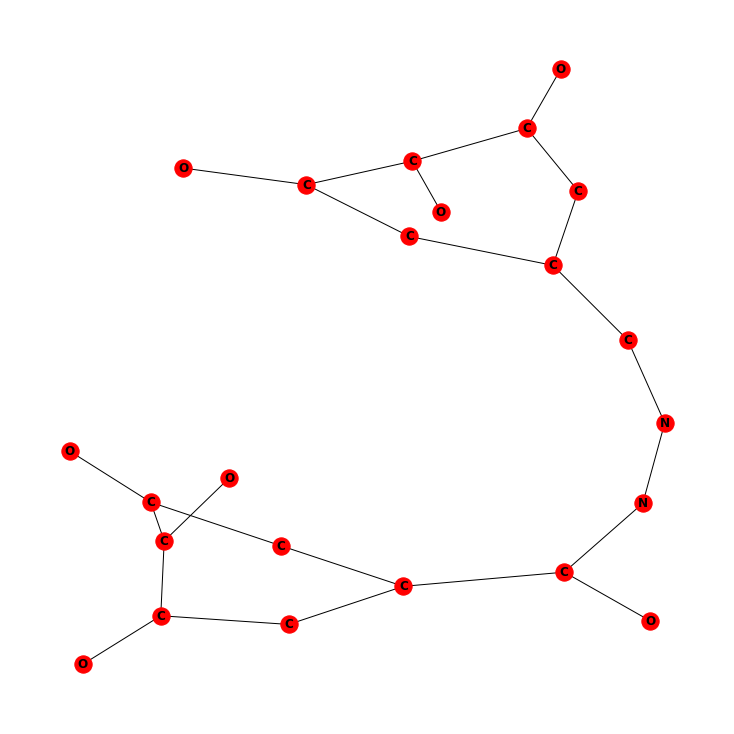

Protein nodes:  46


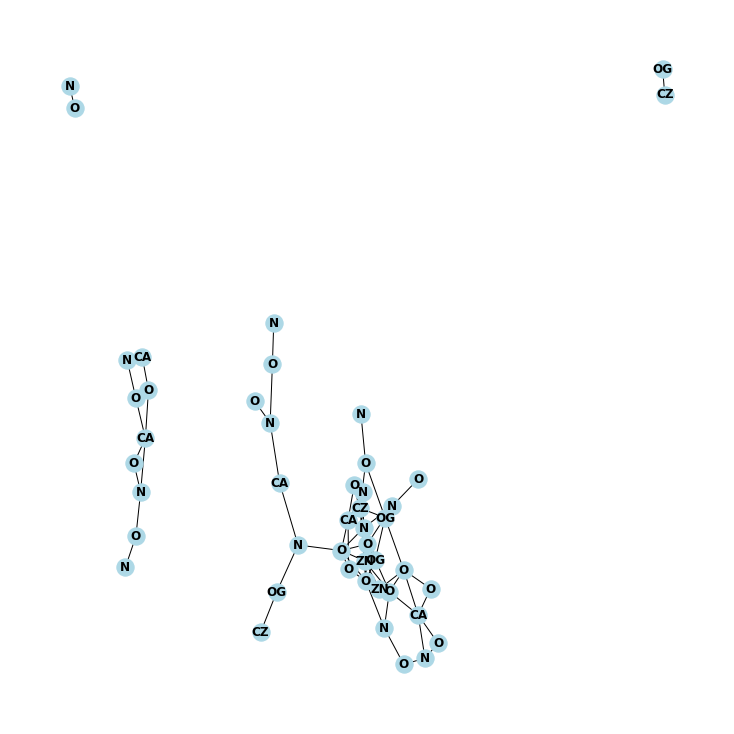

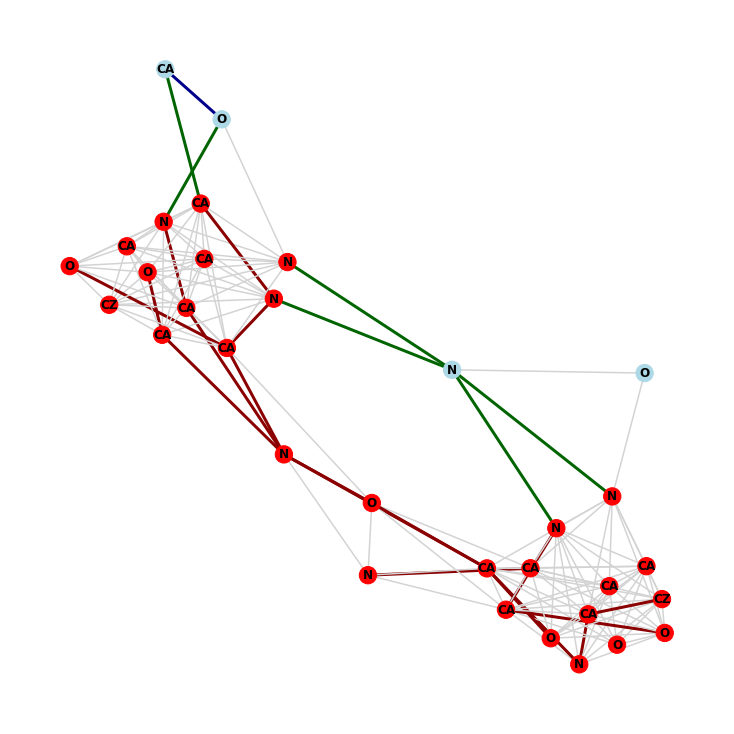

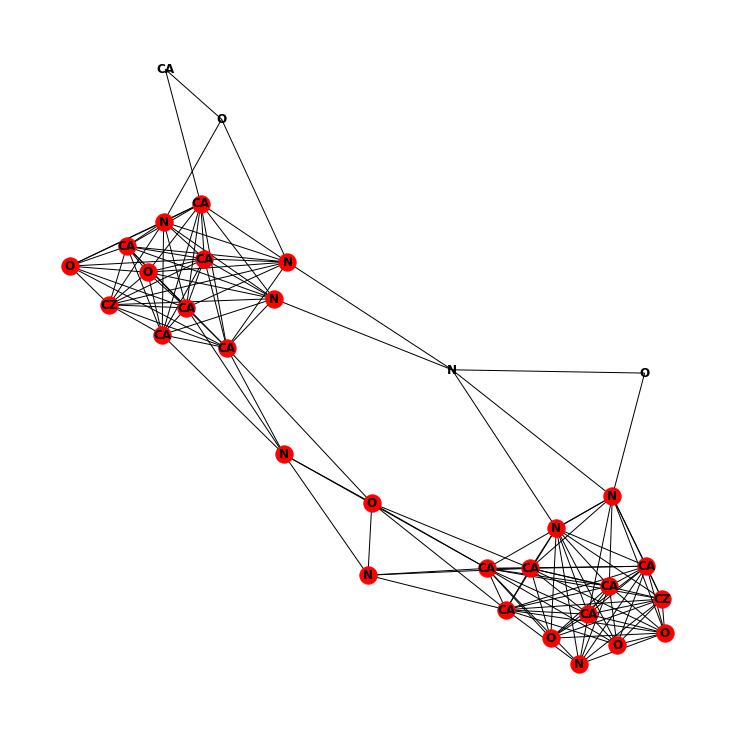

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

In [20]:
AFFINITY_GROUPS = ["low affinity", "medium affinity", "high affinity"]
SELECTED_INTERACTION_NAME = "5ega"
for affinity_group in AFFINITY_GROUPS:
    
    num_relevant_edge_in_protein_list = {key: [] for key in top_k_thresholds}
    num_relevant_edge_in_ligand_list = {key: [] for key in top_k_thresholds}
    num_relevant_edge_in_between_list = {key: [] for key in top_k_thresholds}
    num_total_relevant_edges_list = {key: [] for key in top_k_thresholds}

    num_relevant_absolute_edge_in_protein_list = {key: [] for key in top_k_thresholds}
    num_relevant_absolute_edge_in_ligand_list = {key: [] for key in top_k_thresholds}
    num_relevant_absolute_edge_in_between_list = {key: [] for key in top_k_thresholds}
    num_total_relevant_absolute_list = {key: [] for key in top_k_thresholds}

    num_total_edge_in_protein_list = []
    num_total_edge_in_ligand_list = []
    num_total_edge_in_between_list = []
    num_total_edges_in_graph_list = []

    directory = STATISTICS_FOLDER + affinity_group + "/"
    test_interaction_name = None
    test_interaction_index = None

   

    for file in tqdm(os.listdir(directory)):
        test_interaction_name = os.fsdecode(file)
        if test_interaction_name != SELECTED_INTERACTION_NAME:
            continue

        test_interaction_path = directory + test_interaction_name
        if os.path.isdir(test_interaction_path):
            for i, interaction in enumerate(hold_out_data):
                if interaction.interaction_name == test_interaction_name:
                    test_interaction_index = i
                    break
        else:
            continue
        
        

        test_interaction = hold_out_data[test_interaction_index]
        print("Interaction: " + test_interaction.interaction_name)

        #read phi_edges from file
        phi_edges = []
        
        print(directory + test_interaction_name + "/" + test_interaction_name + "_statistics.txt")

        with open(directory + test_interaction_name + "/" + test_interaction_name + "_statistics.txt", 'r') as f:
            
            shapeley_computed = False
            while not shapeley_computed:
                line = f.readline()
                if line.strip().startswith("Shapley"):
                    f.readline()
                    lines = f.readlines()
                    for line in lines:
                        phi_edges.append(float(line.strip().split(" ")[-1]))
                    shapeley_computed = True


        print(f"Sum of phi edges: {sum(phi_edges)}")
        # print("Phi edges: " + str(phi_edges))
        
        #plotting
        num_bonds = test_interaction.networkx_graph.number_of_edges()


        rdkit_bonds_phi = [0]*num_bonds
        rdkit_bonds = {}

        bonds = dict(test_interaction.networkx_graph.edges())
        bonds = list(bonds.keys())

        for i in range(num_bonds):
            init_atom = bonds[i][0]
            end_atom = bonds[i][1]
            
            rdkit_bonds[(init_atom, end_atom)] = i

        
        if not UNDIRECTED: #check this block, we are maybe summing twice, maybe not: checked, CORRECT
            for i in range(len(phi_edges)):
                phi_value = phi_edges[i]
                init_atom = test_interaction.edge_index[0][i].item()
                end_atom = test_interaction.edge_index[1][i].item()
                
                if (init_atom, end_atom) in rdkit_bonds:
                    bond_index = rdkit_bonds[(init_atom, end_atom)]
                    rdkit_bonds_phi[bond_index] += phi_value
                if (end_atom, init_atom) in rdkit_bonds:
                    bond_index = rdkit_bonds[(end_atom, init_atom)]
                    rdkit_bonds_phi[bond_index] += phi_value
                
        else: #in this case one direction is set to 0 and the other contains the sum. We keep it like this for coherence with odes oreder and plotting (we do not need directions now). Do change since only one dir in our case! Nice
            for i in range(len(phi_edges)):
                phi_value = phi_edges[i]
                init_atom = test_interaction.edge_index[0][i].item()
                end_atom = test_interaction.edge_index[1][i].item()
                
                source_atom = init_atom if init_atom < end_atom else end_atom
                target_atom = end_atom if end_atom > init_atom else init_atom

                bond_index = rdkit_bonds[(source_atom, target_atom)]
                rdkit_bonds_phi[bond_index] += phi_value

        
        # print(rdkit_bonds_phi)

        G = test_interaction.networkx_graph
        print("Number of nodes: ", G.number_of_nodes())
        print("Number of edges: ", G.number_of_edges())

        colors = ["red" if G.nodes[node]["origin"] == "L" else "lightblue" for node in G.nodes]

        

        num_total_edge_in_protein = 0
        num_total_edge_in_ligand = 0
        num_total_edge_in_between = 0

        atoms_origin = nx.get_node_attributes(G, 'origin')

        for bond in bonds:
            init_atom = bond[0]
            end_atom = bond[1]

            if atoms_origin[init_atom] == "P" and atoms_origin[end_atom] == "P":
                num_total_edge_in_protein += 1
            elif atoms_origin[init_atom] == "L" and atoms_origin[end_atom] == "L":
                num_total_edge_in_ligand += 1
            else:
                num_total_edge_in_between += 1

        num_total_edges_in_graph = num_total_edge_in_protein + num_total_edge_in_ligand + num_total_edge_in_between


        print("Number of total edges connecting protein pseudo-atoms: ", num_total_edge_in_protein)
        print("Number of total edges connecting ligand pseudo-atoms: ", num_total_edge_in_ligand)
        print("Number of total edges connecting protein and ligand pseudo-atoms: ", num_total_edge_in_between, "\n")
        
        num_total_edge_in_protein_list.append(num_total_edge_in_protein)
        num_total_edge_in_ligand_list.append(num_total_edge_in_ligand)
        num_total_edge_in_between_list.append(num_total_edge_in_between)
        num_total_edges_in_graph_list.append(num_total_edges_in_graph)


        #for regression we need absolute values to study the overall importance of edges (even negative contrib matters for the regression)
        if SAVE_RESULTS:
            with open(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_statistics_top_k_edges_undirected.txt", "w+") as f:
                f.write("Top k edges statistics\n\n")

        absolute_phi = np.abs(rdkit_bonds_phi)
        #sort indices according to decreasing phi values
        indices_sorted = np.argsort(-absolute_phi)
        

        for top_k_t in top_k_thresholds:

            top_edges = indices_sorted[:top_k_t]

            num_total_top_abs_edges = top_k_t
            num_edge_in_protein = 0
            num_edge_in_ligand = 0
            num_edge_in_between = 0

            atoms_origin = nx.get_node_attributes(G, 'origin')

            edges_to_draw = []
            ligand_nodes = set()
            protein_nodes = set()
            edges_colors = []
            edges_widths = []

            for bond in bonds:
                init_atom = bond[0]
                end_atom = bond[1]

                bond_index = rdkit_bonds[(init_atom, end_atom)]

                if atoms_origin[init_atom] == "P": 
                    protein_nodes.add(init_atom)
                else: 
                    ligand_nodes.add(init_atom)

                if atoms_origin[end_atom] == "P": 
                    protein_nodes.add(end_atom)
                else:
                    ligand_nodes.add(end_atom)

                if bond_index in top_edges:
                    if atoms_origin[init_atom] == "P" and atoms_origin[end_atom] == "P":
                        num_edge_in_protein += 1
                        edges_colors.append("darkblue")
                    elif atoms_origin[init_atom] == "L" and atoms_origin[end_atom] == "L":
                        num_edge_in_ligand += 1
                        edges_colors.append("darkred")
                    else:
                        num_edge_in_between += 1
                        edges_colors.append("darkgreen")
                    edges_widths.append(3)
                
                    edges_to_draw.append((init_atom, end_atom)) #when we draw edges, we do not use this variable
                else:
                    edges_colors.append("lightgrey") 
                    edges_widths.append(1.5)

            ligand_nodes = list(ligand_nodes)
            protein_nodes = list(protein_nodes)
            if PLOT:

                if LIGAND_GRAPH:
                    G_ligand = test_interaction.networkx_ligand_graph
                    print("Ligand nodes: ", G_ligand.number_of_nodes())
                    plt.figure(figsize=(10,10))
                    pos = nx.spring_layout(G_ligand)

                    nx.draw(G_ligand, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G_ligand, 'atom_type'), node_color="red")  #edgelist = edges_to_draw,  

                    plt.show()
                    # plt.savefig(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_EdgeSHAPer_top_" + str(top_k_t) + "_edges_full_graph.png", dpi=300)
                    # sys.exit()
                    plt.close()
                
                if PROTEIN_GRAPH:
                    G_protein = test_interaction.networkx_protein_graph
                    print("Protein nodes: ", G_protein.number_of_nodes())
                    plt.figure(figsize=(10,10))
                    pos = nx.spring_layout(G_protein)

                    nx.draw(G_protein, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G_protein, 'atom_type'), node_color="lightblue")
                    plt.show()
                    plt.close()

                #draw graph with important edges
                plt.figure(figsize=(10,10))
                pos = nx.spring_layout(G)

                nx.draw(G, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G, 'atom_type'), node_color=colors,edge_color=edges_colors, width=edges_widths, edge_cmap=plt.cm.bwr)  #edgelist = edges_to_draw,  
                plt.show()
                # plt.savefig(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_EdgeSHAPer_top_" + str(top_k_t) + "_edges_full_graph.png", dpi=300)
                # sys.exit()
                plt.close()

                #save original graph
                if top_k_t == 25:
                    plt.figure(figsize=(10,10))
                    # pos = nx.spring_layout(G)

                    # nx.draw(G, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G, 'atom_type'), node_color=colors,edge_color=edges_colors, width=3, edge_cmap=plt.cm.bwr)  #edgelist = edges_to_draw,  
                    nx.draw(G, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G, 'atom_type'), node_color="red", nodelist=ligand_nodes)
                    # plt.show()
                    # plt.savefig(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_full_interaction_graph.png", dpi=300)
                    # sys.exit()
                    plt.show()
                    plt.close()
                
            if SAVE_RESULTS:
                with open(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_statistics_top_k_edges_undirected.txt", "a") as f:
                    f.write("Top " + str(top_k_t) + " relevant edges\n\n")
                    if num_total_edge_in_protein == 0:
                        f.write("Number of relevant edges connecting protein pseudo-atoms: 0\n")
                        print("Number of relevant edges connecting protein pseudo-atoms: 0")
                    else:
                        f.write("Number of relevant edges connecting protein pseudo-atoms: " + str(num_edge_in_protein) + " (" + str(round((num_edge_in_protein/num_total_edge_in_protein)*100, 1)) + "%)\n")
                        f.write("% w.r.t. total number of relevant edges: " + str(round((num_edge_in_protein/num_total_top_abs_edges)*100, 1)) + "%)\n")
                        print("Number of relevant edges connecting protein pseudo-atoms: " + str(num_edge_in_protein) + " (" + str(round((num_edge_in_protein/num_total_edge_in_protein)*100, 1)) + "%)")
                        print("% w.r.t. total number of relevant edges: " + str(round((num_edge_in_protein/num_total_top_abs_edges)*100, 1)) + "%)\n")

                    if num_total_edge_in_ligand == 0:
                        f.write("Number of relevant edges connecting ligand pseudo-atoms: 0\n")
                        print("Number of relevant edges connecting ligand pseudo-atoms: 0")
                    else:
                        f.write("Number of relevant edges connecting ligand pseudo-atoms: " + str(num_edge_in_ligand) + " (" + str(round((num_edge_in_ligand/num_total_edge_in_ligand)*100, 1)) + "%)\n")
                        f.write("% w.r.t. total number of relevant edges: " + str(round((num_edge_in_ligand/num_total_top_abs_edges)*100, 1)) + "%)\n")
                        print("Number of relevant edges connecting ligand pseudo-atoms: " + str(num_edge_in_ligand) + " (" + str(round((num_edge_in_ligand/num_total_edge_in_ligand)*100, 1)) + "%)")
                        print("% w.r.t. total number of relevant edges: " + str(round((num_edge_in_ligand/num_total_top_abs_edges)*100, 1)) + "%)\n")
                    
                    if num_total_edge_in_between == 0:
                        f.write("Number of relevant edges connecting protein and ligand pseudo-atoms: 0\n")
                        print("Number of relevant edges connecting protein and ligand pseudo-atoms: 0\n")
                    else:
                        f.write("Number of relevant edges connecting protein and ligand pseudo-atoms: " + str(num_edge_in_between) + " (" + str(round((num_edge_in_between/num_total_edge_in_between)*100, 1)) + "%)\n")
                        f.write("% w.r.t. total number of relevant edges: " + str(round((num_edge_in_between/num_total_top_abs_edges)*100, 1)) + "%)\n\n")
                        print("Number of relevant edges connecting protein and ligand pseudo-atoms: " + str(num_edge_in_between) + " (" + str(round((num_edge_in_between/num_total_edge_in_between)*100, 1)) + "%)")
                        print("% w.r.t. total number of relevant edges: " + str(round((num_edge_in_between/num_total_top_abs_edges)*100, 1)) + "%)\n")

            
                    num_relevant_edge_in_protein_list[top_k_t].append(num_edge_in_protein)
                    num_relevant_edge_in_ligand_list[top_k_t].append(num_edge_in_ligand)
                    num_relevant_edge_in_between_list[top_k_t].append(num_edge_in_between)
                    num_total_relevant_edges_list[top_k_t].append(num_total_top_abs_edges)

    if SAVE_RESULTS:
        with open(directory + "/statistics_top_k_edges_undirected.txt", "w+") as f:
            f.write("Top k edges statistics\n\n")

        for top_k_t in top_k_thresholds:

            with open(directory + "/statistics_top_k_edges_undirected.txt", "a") as f:

                f.write("Top " + str(top_k_t) + " relevant edges\n\n")
                f.write("Avg number of edges in protein: " + str(round(np.mean(num_total_edge_in_protein_list), 3)) + "\n")
                f.write("Avg number of edges in ligand: " + str(round(np.mean(num_total_edge_in_ligand_list), 3)) + "\n")
                f.write("Avg number of edges in interaction: " + str(round(np.mean(num_total_edge_in_between_list), 3)) + "\n\n")
                
                f.write("Avg total number of relevant edges: " + str(round(np.mean(num_total_relevant_edges_list[top_k_t]), 3)) + " (" + str(round((np.mean(num_total_relevant_edges_list[top_k_t])/np.mean(num_total_edges_in_graph_list))*100, 1)) + "%)\n\n")
                f.write("Avg number of relevant edges in protein: " +  str(round(np.mean(num_relevant_edge_in_protein_list[top_k_t]), 3)) + " (" + str(round((np.mean(num_relevant_edge_in_protein_list[top_k_t])/np.mean(num_total_edge_in_protein_list))*100, 1)) + "%)\n")
                f.write("% w.r.t. total number of relevant edges: " + str(round((np.mean(num_relevant_edge_in_protein_list[top_k_t])/np.mean(num_total_relevant_edges_list[top_k_t]))*100, 1)) + "%\n")
                f.write("Avg number of relevant edges in ligand: " +  str(round(np.mean(num_relevant_edge_in_ligand_list[top_k_t]), 3)) + " (" + str(round((np.mean(num_relevant_edge_in_ligand_list[top_k_t])/np.mean(num_total_edge_in_ligand_list))*100, 1)) + "%)\n")
                f.write("% w.r.t. total number of relevant edges: " + str(round((np.mean(num_relevant_edge_in_ligand_list[top_k_t])/np.mean(num_total_relevant_edges_list[top_k_t]))*100, 1)) + "%\n")
                f.write("Avg number of relevant edges in interaction: " + str(round(np.mean(num_relevant_edge_in_between_list[top_k_t]), 3)) + " (" + str(round((np.mean(num_relevant_edge_in_between_list[top_k_t])/np.mean(num_total_edge_in_between_list))*100, 1)) + "%)\n")
                f.write("% w.r.t. total number of relevant edges: " + str(round((np.mean(num_relevant_edge_in_between_list[top_k_t])/np.mean(num_total_relevant_edges_list[top_k_t]))*100, 1)) + "%\n\n")

Ligand nodes:  23


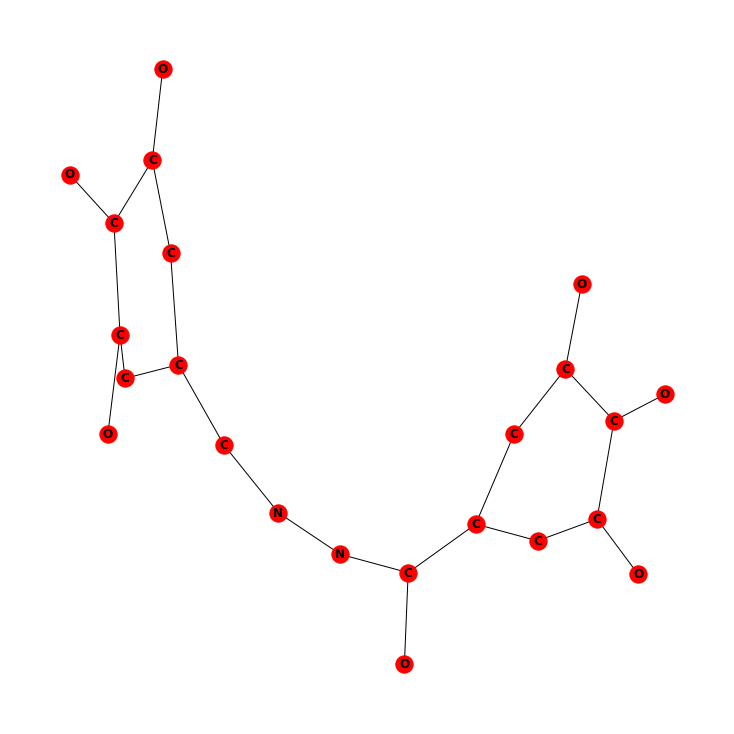

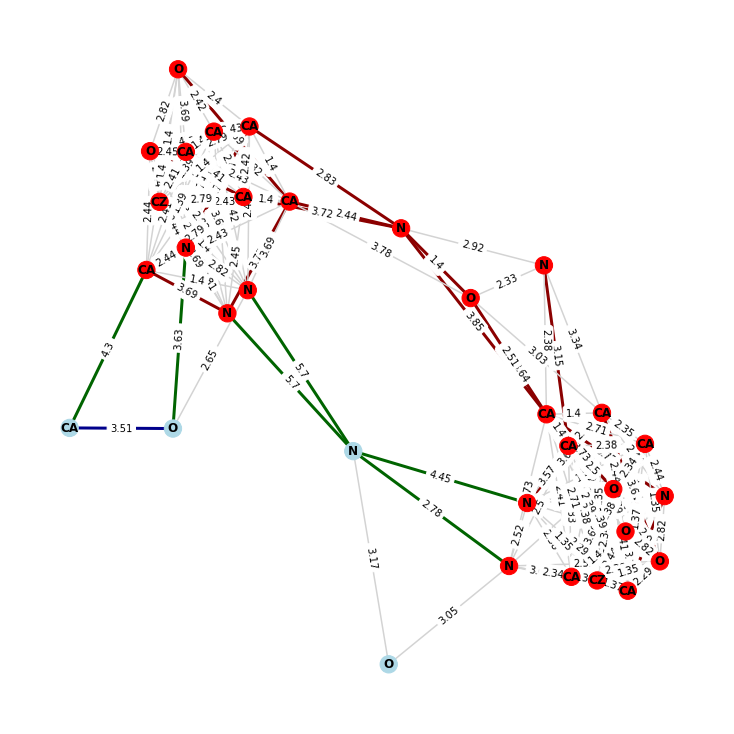

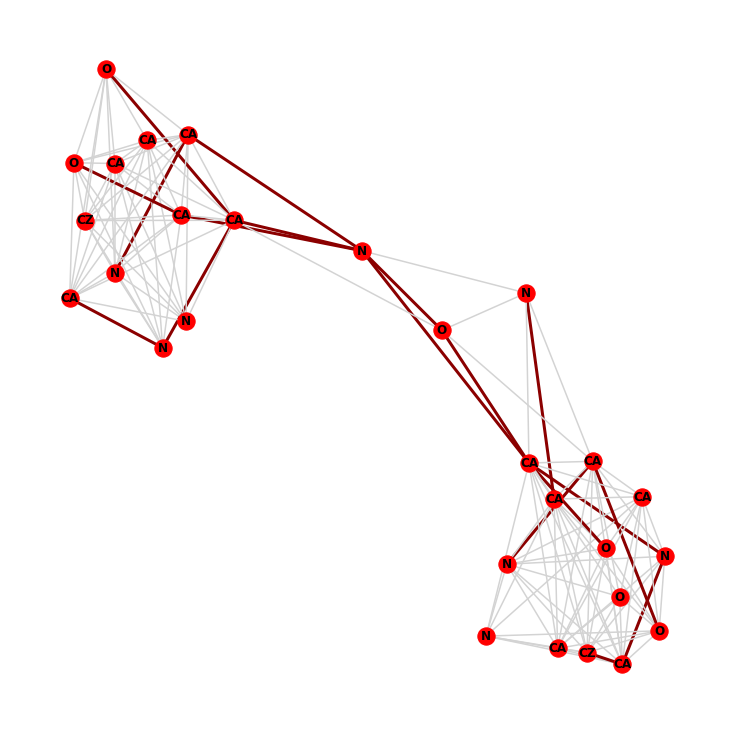

In [42]:
if LIGAND_GRAPH:
    G_ligand = test_interaction.networkx_ligand_graph
    print("Ligand nodes: ", G_ligand.number_of_nodes())
    plt.figure(figsize=(10,10))
    pos = nx.spring_layout(G_ligand)

    nx.draw(G_ligand, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G_ligand, 'atom_type'), node_color="red")  #edgelist = edges_to_draw,  

    plt.show()
    # plt.savefig(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_EdgeSHAPer_top_" + str(top_k_t) + "_edges_full_graph.png", dpi=300)
    # sys.exit()
    plt.close()

    # if PROTEIN_GRAPH:
    #     G_protein = test_interaction.networkx_protein_graph
    #     print("Protein nodes: ", G_protein.number_of_nodes())
    #     plt.figure(figsize=(10,10))
    #     pos = nx.spring_layout(G_protein)

    #     nx.draw(G_protein, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G_protein, 'atom_type'), node_color="lightblue")
    #     plt.show()
    #     plt.close()

    #draw graph with important edges on interaction graph
    plt.figure(figsize=(10,10))
    pos = nx.spring_layout(G)

     
    nx.draw(G, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G, 'atom_type'), node_color=colors,edge_color=edges_colors, width=edges_widths, edge_cmap=plt.cm.bwr)  #edgelist = edges_to_draw, 
    nx.draw_networkx_edge_labels(G, pos, edge_labels=nx.get_edge_attributes(G, 'weight'), font_color='black')
    plt.show()
    # plt.savefig(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_EdgeSHAPer_top_" + str(top_k_t) + "_edges_full_graph.png", dpi=300)
    # sys.exit()
    plt.close()

    #draw original graph - interaction graph
    node_labels = nx.get_node_attributes(G, 'atom_type')
    ligand_node_labels = {k: v for k, v in node_labels.items() if k in ligand_nodes}
    ligand_edges = [(u, v) for (u, v) in G.edges() if u in ligand_nodes and v in ligand_nodes]
    ligand_edges_colors = []
    ligand_edges_widths = []
    for bond in bonds:
        init_atom = bond[0]
        end_atom = bond[1]

        bond_index = rdkit_bonds[(init_atom, end_atom)]
        if (init_atom, end_atom) in ligand_edges: 
            if bond_index in top_edges:
                if atoms_origin[init_atom] == "P" and atoms_origin[end_atom] == "P":
                    num_edge_in_protein += 1
                    ligand_edges_colors.append("darkblue")
                elif atoms_origin[init_atom] == "L" and atoms_origin[end_atom] == "L":
                    num_edge_in_ligand += 1
                    ligand_edges_colors.append("darkred")
                else:
                    num_edge_in_between += 1
                    ligand_edges_colors.append("darkgreen")
                ligand_edges_widths.append(3)
            
                edges_to_draw.append((init_atom, end_atom)) #when we draw all edges, we do not use this variable
            else:
                ligand_edges_colors.append("lightgrey") 
                ligand_edges_widths.append(1.5)

    plt.figure(figsize=(10,10))
    # pos = nx.spring_layout(G)
    # pos = nx.spring_layout(G_ligand)
    # nx.draw(G, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G, 'atom_type'), node_color=colors,edge_color=edges_colors, width=3, edge_cmap=plt.cm.bwr)  #edgelist = edges_to_draw,  
    nx.draw(G, pos=pos, with_labels=True, font_weight='bold', labels=ligand_node_labels, node_color="red", edgelist=ligand_edges, nodelist=ligand_nodes, edge_color=ligand_edges_colors, width=ligand_edges_widths, edge_cmap=plt.cm.bwr)  #edgelist = edges_to_draw,
    # nx.draw(G_ligand, pos=pos, with_labels=True, font_weight='bold', labels=nx.get_node_attributes(G_ligand, 'atom_type'), node_color="red")
    # plt.show()
    # plt.savefig(directory + test_interaction_name + "/" + test_interaction.interaction_name + "_full_interaction_graph.png", dpi=300)
    # sys.exit()
    plt.show()
    plt.close()